# AirBnB Analysis using Geoplotlib 

Team:
- Nikhit Soares
- Poonam Patil
- Sheetal Kalburgi
- Swati Kohli

## About Geoplotlib

- Geoplotlib is an open-source python toolbox for visualizing geo-graphical data. Geographical data visualization is a fundamental tool for communicating results related to geospatial analyses, and for generating hypotheses during exploratory data analysis.


- Geoplotlib uses numpy/scipy for fast numerical computations, and pyglet/OpenGL for hardware-accelerated graphical rendering. This allows the visualizations to scale to millions of datapoints in realtime.


- Provides implementations of dot density maps,choropleths,heatmaps, kernel density estimation, spatial graphs, Voronoi tesselation and and many more  spatial visualizations. We describe geoplotlib design, functionalities and use cases.


- Simple yet powerful API to generate geographical visualizations on OpenStreetMap tiles.


- API refrences are available here: https://andrea-cuttone.github.io/geoplotlib/api.html

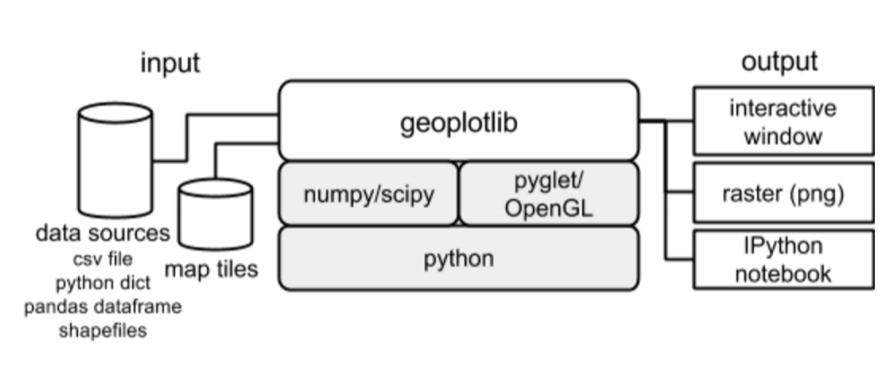

In [1]:
from IPython.display import Image # This library is used to display images
Image("geoplotlib.png", width=800, height=450)

### Installation

Geoplotlib requires:
1. numpy
2. pyglet 1.2.4

Note: in order for pyglet to work with ipython on Mac, version 1.2.4 or newer is needed

In [2]:
# To install from source run:
# python setup.py install

# Or with pip: 
# pip install geoplotlib
# pip install pyglet

### Applications and Uses

Geoplotlib is used for:
1. communicating results related to geospatial analyses
2. for generating hypotheses during exploratory data analysis
3. supporting interactive data analysis
4. facilitating the iterative design for visualizations.

Limitations: 
- Currently, however,there is limited support for geographical visualization.

In [3]:
import pandas as pd
import numpy as np

import pyglet # For graphical rendering

import geoplotlib 
from geoplotlib.utils import read_csv # Read a csv file into a DataAccessObject
import geoplotlib.colors as colors  # Module to access colors 
from geoplotlib.colors import colorbrewer # Dictionary of colours for unique values used for Colour maps
from geoplotlib.utils import BoundingBox # To represent a map boundingbox

### To demonstrate geoplot, it is necessary to convert a dataframe from Pandas to DataAccessObject

For demonstarting geoplotlib visualisations, we will use AirBnB listings data set.

In [4]:
airbnbData = pd.read_csv("AirbnbListingCA.csv")

airbnbData.columns

Index(['id', 'name', 'host_id', 'host_name', 'host_since', 'host_location',
       'host_is_superhost', 'street', 'city', 'state', 'zipcode',
       'country_code', 'latitude', 'longitude', 'property_type', 'bedrooms',
       'square_feet', 'price', 'review_scores_rating', 'reviews_per_month'],
      dtype='object')

In [5]:
#Select relevant columns
location = airbnbData[['city','latitude','longitude']] 
location.columns = ['city','lat','lon'] # Required to convert coordinate column names to 'lat' and 'lon' for Dot Plot
location.head()

,city,lat,lon
0,San Francisco,37.76931,-122.43386
1,San Francisco,37.75402,-122.45805
2,San Francisco,37.74511,-122.42102
3,San Francisco,37.76669,-122.45250
4,San Francisco,37.76487,-122.45183


## Most features of Geoplotlib reads Data Access Objects. For the same follow any of the two methods below.

### Method 1: Read the CSV file and perform necessary modification. Save the new CSV and re-read it as DataAccessObject

In [6]:
#save the new file
location.to_csv('airbnbLocation.csv')

In [7]:
#read the new file as a DAO
location = read_csv('airbnbLocation.csv')

### Method 2: Use in-built class 'DataAccessObject'

In [8]:
from geoplotlib.utils import DataAccessObject

location = airbnbData[['city','latitude','longitude']]
location.columns = ['city','lat','lon'] 

# this in built feature allows to directly conver pandas datafram to DAO
location = DataAccessObject.from_dataframe(location)

location.head(5)

DataAccessObject(['city', 'lat', 'lon'] x 5)

### Controlling the map view

#### Navigation shortcuts:
- P: take a screenshot named with the current timestamp and save it in the current python working directory
- M: toggle base tiles map rendering
- L: toggle layers rendering
- I/O: zoom in/out
- A/D: pan left/right
- W/S: pan up/down
- R: force invalidating all layers

#### BoundingBox:
The map view is determined by the projection parameters: latitude, longitude and zoom level. By default, the projection is chosen to fit all selected points, with the maximum zoom level possible. The view can be changed to a specific portion of the map by passing a 'BoundingBox' object to the set_bbox method. A BoundingBox object defines the map view boundaries, and can be constructed in multiple ways. The most direct way is to specify two ranges of latitudes and longitudes.

To find NSEW coordinates of a region to set bounding box on www.openstreetmap.org

**Method 1:** 
- Type particular area 
- Go to the "export" tab(on top) and it shows the coordinates

**Method 2:**
- Go to the "export" tab(on top)
- Click on "manually select a different area" 
- Draw the rectangle and read the coordinates from the four text boxes on the left


**Outputs obtained from geoplotlib are of three types:**
1. Rendered image: Map opens up in a new window. Images take some time to render, unfortunately.
   - using: geoplotlib.show()
2. Screenshot: Launches geoplotlib, saves a screeshot and terminates. 
   - using: geoplotlib.savefig()
3. Inline: Display the map inline in ipython.
   - using: geoplotlib.inline()

In [9]:
# For ready Reference
# BoundingBox for San Francisco & Bay Area
bboxSF = BoundingBox(north =37.8304, west = -122.54701, south = 37.2227, east = -121.7381)
geoplotlib.set_bbox(bboxSF)
geoplotlib.show()

In [10]:
# BoundingBox for USA
bboxUSA = BoundingBox(north =51.3, west = -124.3, south = 14.8, east = -56.8)
geoplotlib.set_bbox(bboxUSA)
geoplotlib.show()

## Let's Explore some Features

## Feature 1: Dot Plot

An elementary operation in geographical visualization is to display “what is where”, that is to place a graphic element on the map for each of the objects in consideration. This provides an immediate idea of the absolute and relative locations of objects. The density of points directly maps to the density of objects on geographical surface, identifying zones of higher and lower density.   
The dot map shows the spatial distribution of AirBnB listing in San Francisco at a glance.

In [11]:
# Feature1: Dot Plot using world map from python 
# Remember to convert the coordinate column names as 'lat' 'lon' in the same order
geoplotlib.dot(location)
geoplotlib.set_bbox(bboxSF)
geoplotlib.show() # Display the geoplot
geoplotlib.savefig('location_dotplot.png') # This allows you to take a picture/screenshot of the geoplot and save it.

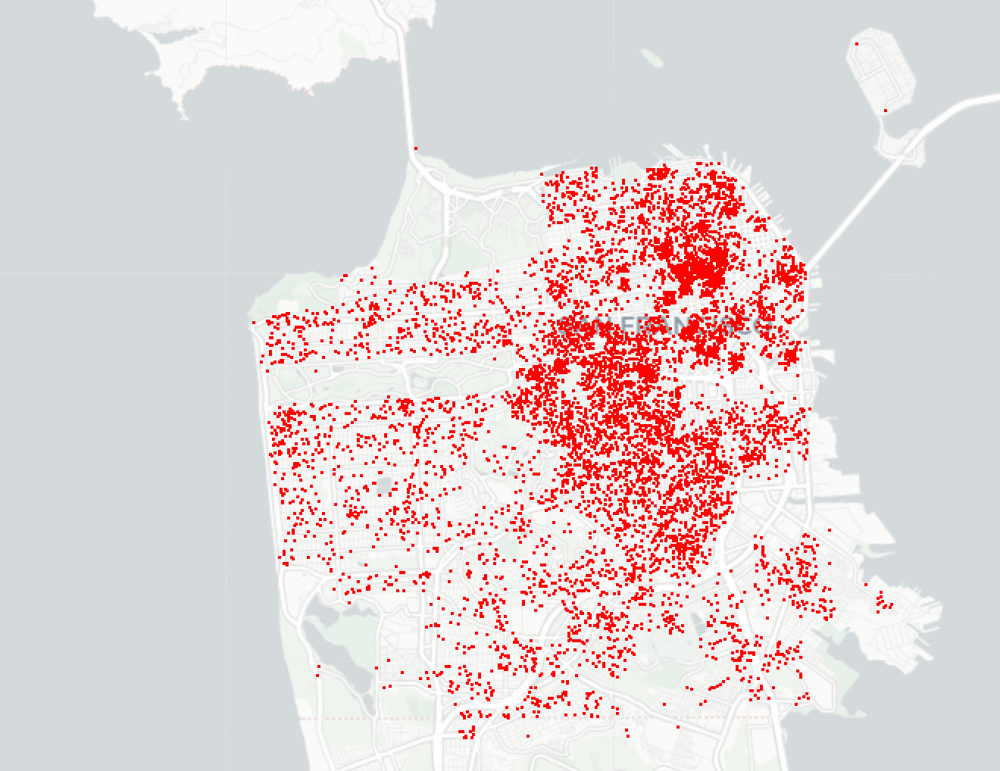

In [12]:
Image("dot.png", width=800, height=450)

**Interpretation:**

The dot map of the AirBnB listing in San Francisco, where each sample is represented by a point, has the highest density in the Financial District region. This is plausible as financial district attracts more busineeses and in turn  executives who visit for businness/ official purposes.  
Additionaly, Mission District also has a dense collection of the dots. Being a residential area with the perks of being close to financial district, makes Mission District region a good candidate to have higher AirBnB listing compared to other residential areas.

## Map Tiles

An interesting feature of geoplotlib is that, it provides the ability to have different map tiles as a base. A simple dot plot can be changed to have a different background, such as a watercolour map as shown in the below code. A number of common free tiles providers are supported, including Stamen Watercolor and Toner, CartoDB Positron and DarkMatter. 

In [13]:
# Map Tile
geoplotlib.tiles_provider({
    'url': lambda zoom, xtile, ytile: 'http://a.tile.stamen.com/watercolor/%d/%d/%d.png' % (zoom, xtile, ytile),
    'tiles_dir': 'mytiles',
    'attribution': 'my attribution'
})

## Layering

Geoplotlib allows to overlay multiple plots and most features of Geoplotlib can be overlayed on top of each other. This is called layering. Let's try doing some.

In [14]:
# Dot plot overlayed on Map Tile

# Layer 1 Map Tile
geoplotlib.tiles_provider({
    'url': lambda zoom, xtile, ytile: 'http://a.tile.stamen.com/watercolor/%d/%d/%d.png' % (zoom, xtile, ytile),
    'tiles_dir': 'mytiles',
    'attribution': 'my attribution'
})

# Layer 2 Dot Plot
geoplotlib.dot(location, 'r')

geoplotlib.set_bbox(bboxSF) # set bounding box
geoplotlib.show()

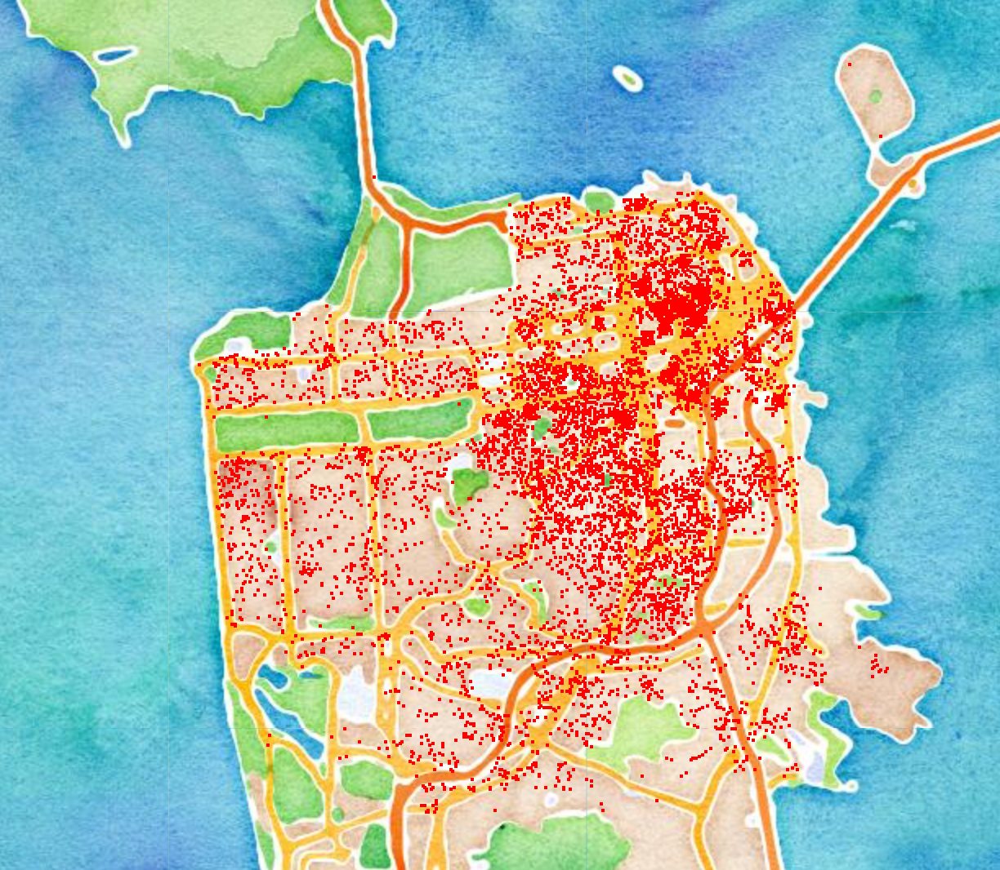

In [15]:
Image("layer1.png", width=800, height=450)

Lables can also be added as another layer.  
Let's check out the prices of all the listings in Daly city.

In [16]:
# subset the dataframe to get prices of Daly City 
price = airbnbData[airbnbData['city']=='Daly City'][['price','latitude','longitude']]
price.columns = ['price','lat','lon'] # get the appropriate format
price_DC = DataAccessObject.from_dataframe(price) # Convert to DAO using the in-built class

In [17]:
# Layer 1 Map Tile base
geoplotlib.tiles_provider({
    'url': lambda zoom, xtile, ytile: 'http://a.tile.stamen.com/watercolor/%d/%d/%d.png' % (zoom, xtile, ytile),
    'tiles_dir': 'mytiles',
    'attribution': 'my attribution'
})

# Layer 2 Dot plot
geoplotlib.dot(location, 'r')


# layer 3 Add labels
geoplotlib.labels( data = price_DC, label_column = 'price', color = 'b', font_size =10, anchor_x='center') # set some parameters
geoplotlib.set_bbox(bboxSF)
geoplotlib.show()


**Zoom in to check the prices**

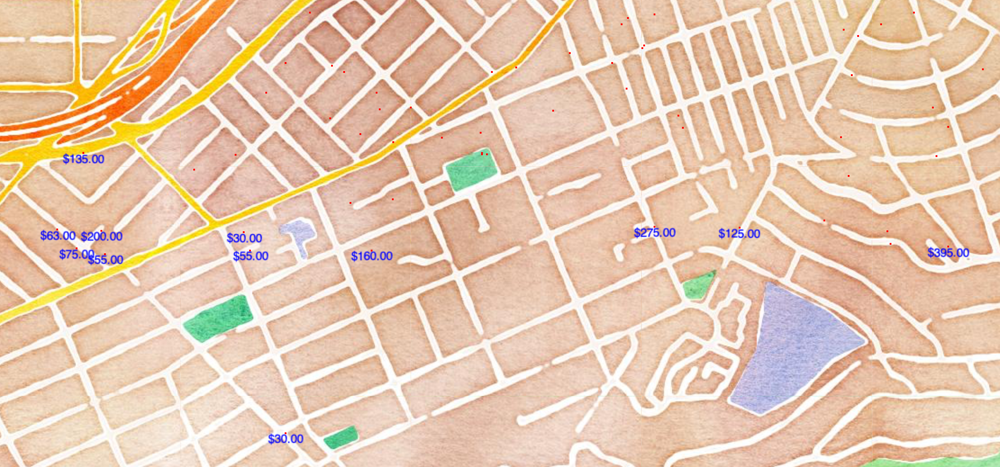

In [18]:
Image("pricemarker.png", width=800, height=450)

## Feature 2: Heatmap

### 2D Histogram

One limitation of dot maps is that, it is hard to distinguish between areas of high density, as the number of point is so high that they uniformly cover the visualization canvas. A more direct visualization of density is to compute a 2D histogram of point coordinates. A uniformly spaced grid is placed on the map, and the number of samples within each cell is counted.

In [19]:
# 2D Histogram
geoplotlib.hist(location, cmap ='cool', colorscale = 'sqrt', binsize = 8) #Here binsize refers to the size in pixels of the histogram bins.
geoplotlib.show()

b'invalid operation'
b'invalid operation'


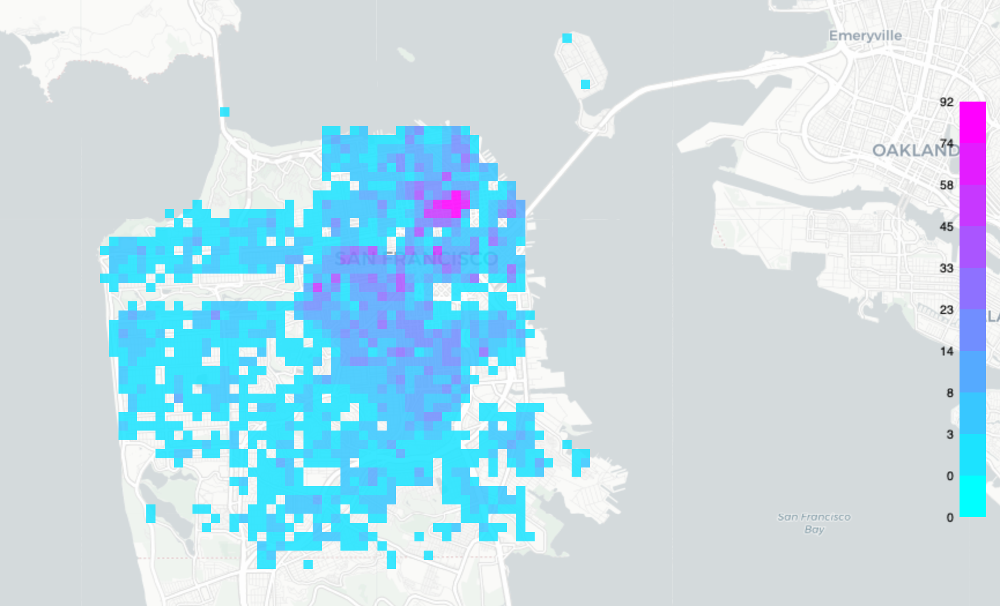

In [20]:
Image("histogram.png", width=800, height=450)

Compared to the dot map example, the histogram provides a clearer depiction of the density distribution. A 2D histogram of AirBnB locations in San Francisco, using the 'cool' colormap shows lower desnity region by lighter blue and higher density by pink-purple is higher.  

**Interpretation:**  

In the graph, area around Union Square shows high density of AirBnB listings.

### KDE: Kernel Density Estimation

Further to 2D Histogram, the main drawback of histogram visualizations is that they are discrete approximations of a (effectively continuous) density function. This creates a dependence on the bin size and offset, rendering histograms sensitive to noise and outliers.

To generate a smoother approximation, a kernel density estimator approximates the true density function by applying kernel functions in a window around each point. The size of this window depends on the bandwidth parameter: a
smaller bandwidth will produce more detailed but also noisier estimation, while a larger bandwidth will produce a less detailed but smoother estimation. A kernel estimation function can then be visualized by a surface where the color
encodes the density value (this visualization is often called a “heatmap”).

In [21]:
# KDE
geoplotlib.kde(location, bw = [8,8], cmap = 'cool') # scaling can be done as well using scaling paramter 'scaling = lin/log/sqrt'
                                                    # bw is bandwidth parameter, used to regulate the smoothness

geoplotlib.set_bbox(bboxSF) # Set a bounding box for San Francisco
geoplotlib.show()

('smallest non-zero count', 8.396366705970284e-10)
('max count:', 3.8536482894594535)


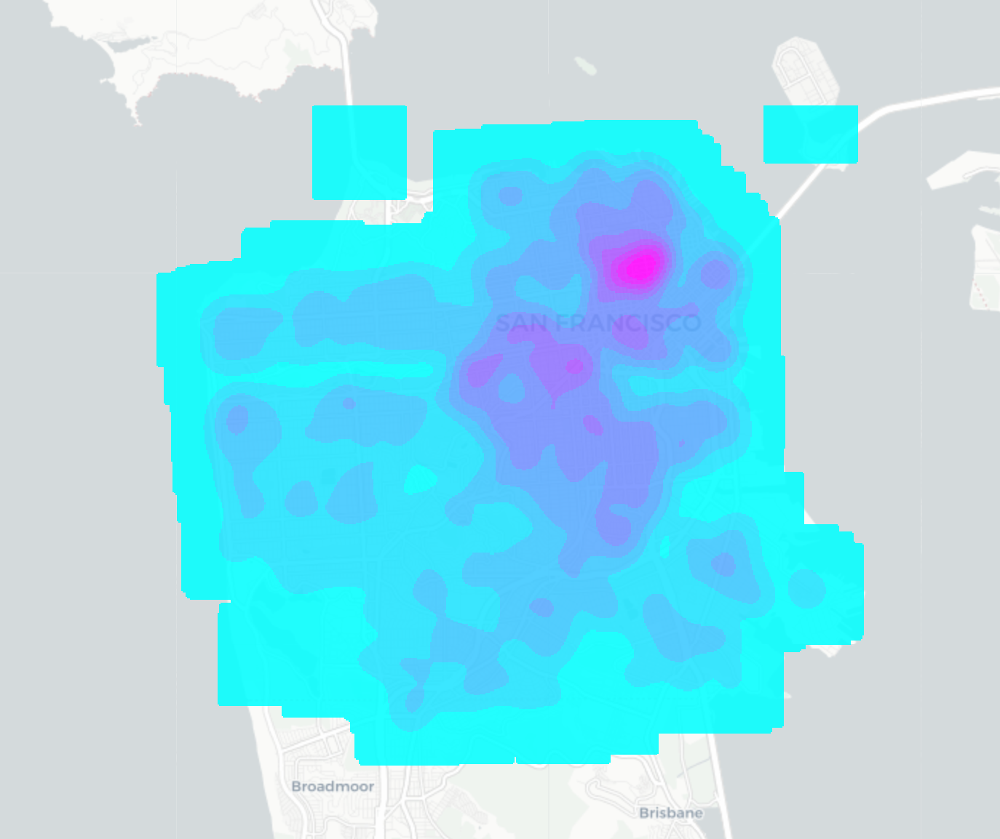

In [22]:
Image("kde.png", width=800, height=450)

**Zoom in to see the difference.**  

Comparing the 2D histogram with the KDE, it is evident how the latter produces a smoother and consequently clearer visualization of density. The kernel bandwidth can be configured to regulate the smoothness.

## Feature 3: Voronoi Tessellation

A Voronoi tessellation is a partition of space into regions induced by points, so that each region (called a Voronoi cell) consists of all points closer to a specific point than to any others. The analysis of Voronoi tessellation is used in numerous fields including ecology, hydrology, epidemiology, mining and mobility studies.
Voronoi cell fill, shading and colors can be configured. In a Voronoi tessellation, each pair of data points is separated by a (perpendicular) line such that it is equally distant from both the data points. As a result, the closer the data points, the smaller the cells.

In [23]:
# Voronoi without fill
geoplotlib.voronoi(location, line_color = 'b', f_tooltip = lambda d:d['city'], line_width=1) # f_tooltip adds labels when you hover over
geoplotlib.show()

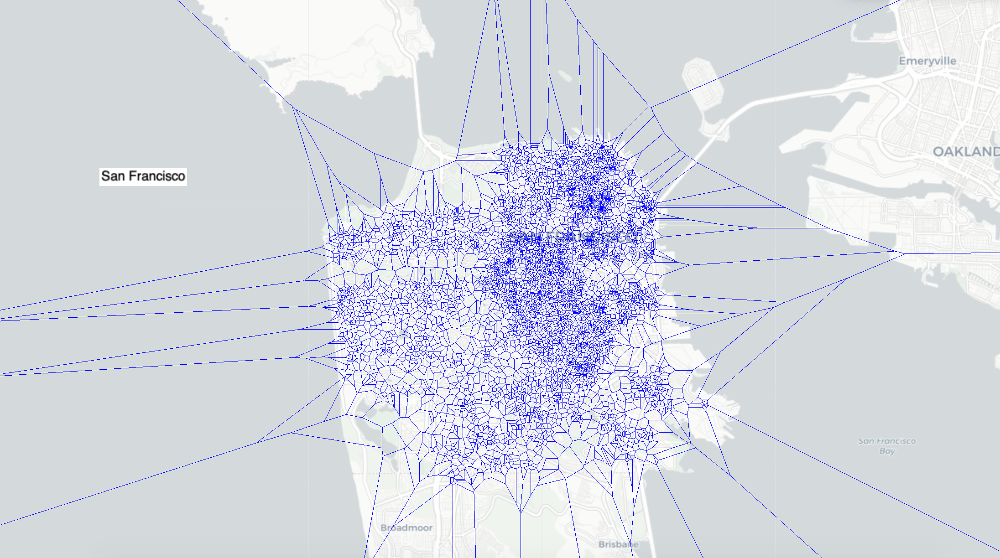

In [24]:
Image("voronoi.png", width=800, height=450)

In [25]:
# Voronoi with fill
geoplotlib.voronoi(location, f_tooltip = lambda d:d['city'], cmap='Blues_r', max_area=10000.0, alpha=150,) # f_tooltip adds labels when you hover over
geoplotlib.show()

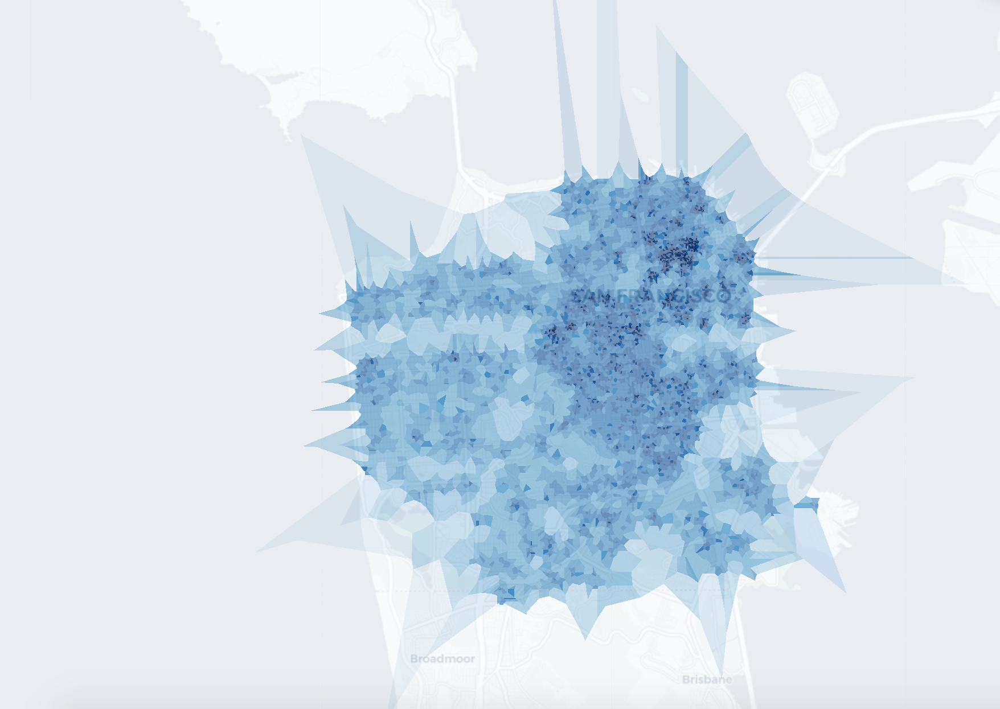

In [26]:
Image("voronoi_filled.png", width=800, height=450)

**Interpretation:**

In this example of Voronoi tessellation, the Voronoi cells provide a measure of the space closer to one AirBnB than any others. The density of points is also captured by the size of Voronoi cells, as smaller cells indicate more densely covered areas.

A Delaunay triangulation is yet another convenient method for generating triangle meshes from a set of points. In geoplotlib the delaunay method can be used for this purpose. The edge color can be configured to a fixed value, or to encode the length of the edges.

In [27]:
# Delaunay
geoplotlib.delaunay(location, cmap='hot_r')
geoplotlib.set_bbox(bboxSF)
geoplotlib.set_smoothing(True)
geoplotlib.show()

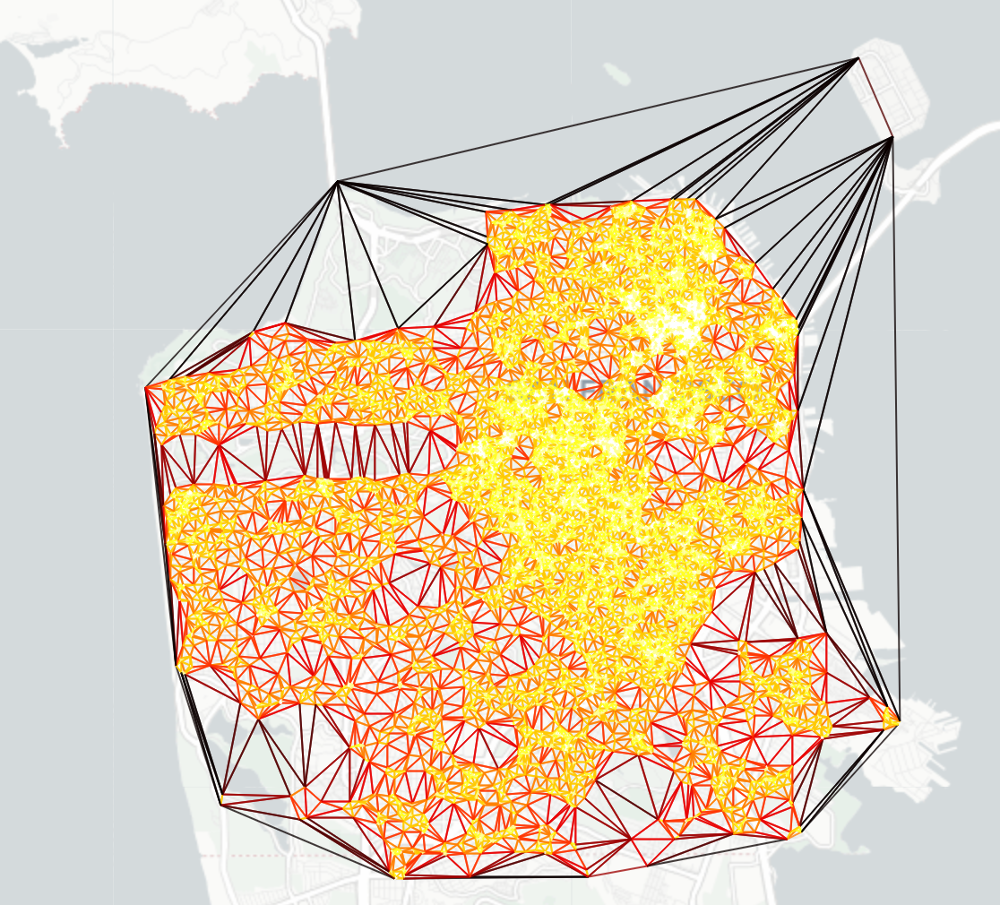

In [28]:
Image("delaunay.png", width=800, height=450)

**Interpretation:**  

Graph shows a Delaunay triangulation AirBnB in San Francisco, with edges colored according to length.

### Let's layer a Voronoi plot over a Dot plot.

In [29]:
# Layering Dot plot and Voronoi
geoplotlib.dot(location, 'r') # Dot plot Layer
geoplotlib.voronoi(location, line_color='b', f_tooltip=lambda d:d['city'], line_width=1) #Voronoi Layer
geoplotlib.set_smoothing(True)
geoplotlib.set_bbox(bboxSF)
geoplotlib.show()

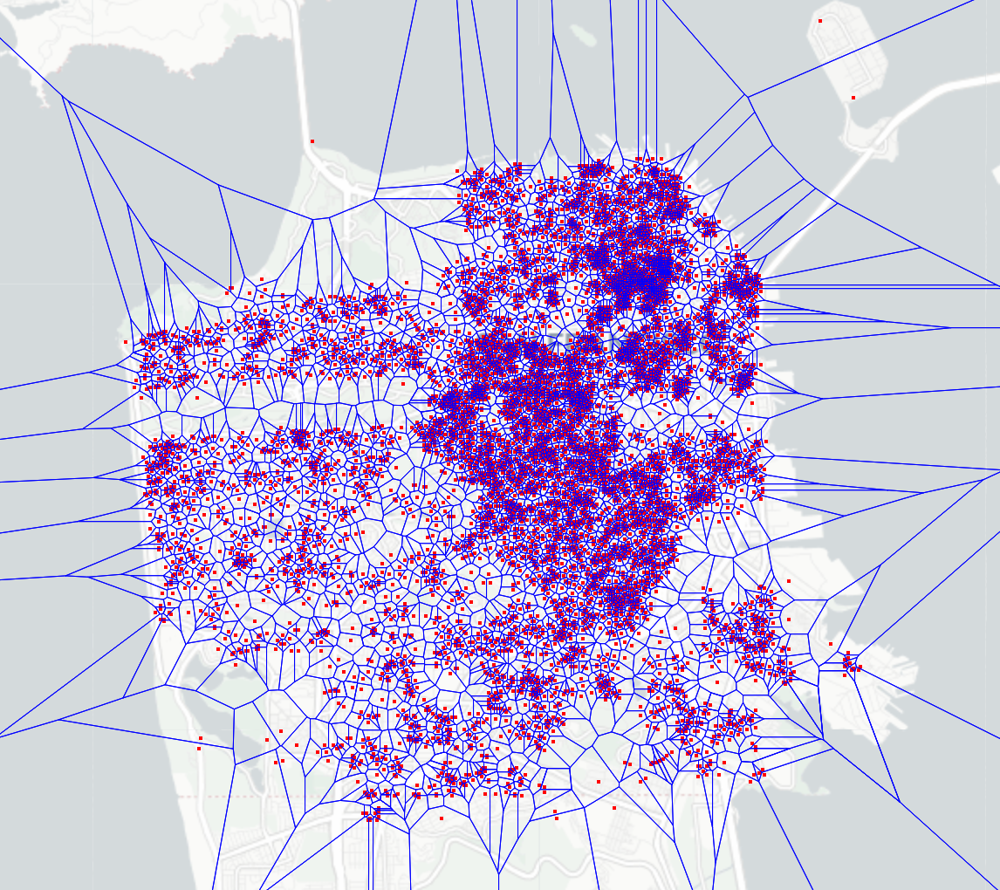

In [30]:
Image("layer2.png", width=800, height=450)

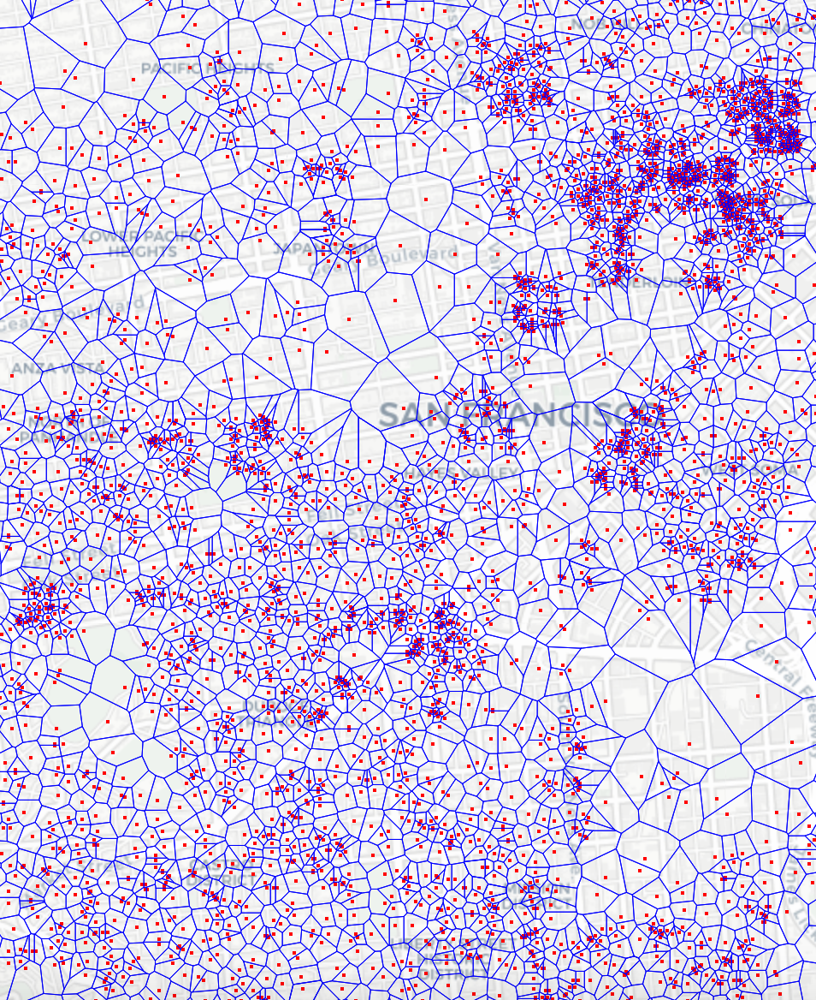

In [31]:
Image("layer2_enlarged.png", width=400, height=400)

### Comparison and Similarity 

#### Differences

The matplotlib library has become the de-facto standard for data visualization in python and provides a large array of visualization tools including scatter and line plots, surface views, 3D plots, barcharts, and boxplots, but it does not provide any support for visualization on a geographical map by default.

The Basemap and Cartopy packages PySAL is an open-source library. These libraries however do not allow a user to draw on map tiles, and have limited support for custom visualizations, interactivity,and animation. The Basemap is powerful but at the cost of being too cumbersome by having a ton of dependencies if we want to get our desired map.

GeoPandas is a fantastic library that makes munging geographic data in Python easy.In fact, it is actually built on top of pandas, with data structures like “GeoSeries” and “GeoDataFrame” that extend the equivalent pandas data structures with useful geographic data crunching features. So, you get all the goodness of pandas, with geographic capabilities baked in.

Folium library is a leaflet.js library which allows to generate html maps without writing a single javascript code. Overall, Folium strikes a great balance between features, customizability, and ease of programming.

Most of these libraries and other geo-plotting available libraries have a lot of dependencies and can give a hard time installing through our python kernel. Many a times you have to restart the kernel and start over again to download these libraries again which demands more computation power as well.

#### Similarities

The geo-plotlib API is inspired by the matplotlib programming model and
syntax, the de-facto standard for data visualization in python; this makes
it easier for matplotlib users to get started.

The visualization canvas is initially empty, and each command adds a
new layer of graphics. The geoplotlib window is displayed when show() is called.
Alternatively, the map can be rendered to image file using savefig('filename'),
or displayed inline in an IPython notebook using inline().

The biggest advantage of geoplotlib is that it is easy to download library with too less dependencies and easy to use and generate customizable maps. Having less dependencies makes the computation speed faster as well. 

#### Lastly

Additionally, there are more advanced features available in geoplotlib such as:
   1. Animation with time stamp: animation feature work ONLY on time stamp data
   2. Choropleth: each geographic unit is coloured to show a continuous variable
   3. Custom layering: enables you to create and add custom layers 

#### References:
- http://www.marknagelberg.com/overview-python-and-non-python-mapping-tools-for-data-scientists/
- https://www.researchgate.net/publication/305983877_Geoplotlib_a_Python_Toolbox_for_Visualizing_Geographical_Data
- https://github.com/andrea-cuttone/geoplotlib
- https://github.com/AntoineSueur/Geoplot-landslides
-  https://nbviewer.jupyter.org/github/amrrs/mapping_wifi_wigle_r_py/blob/master/Building%20Wifi%20Spots%20Map%20with%20Python%20and%20WiGLE.ipynb